# 3D Data Processing

---
A.A. 2024 - Wanmeng Li, Daniel Fusaro
---


## Lab - PointNet: Point Cloud 3D Descriptors

original paper -
[PointNet: Deep Learning on Point Sets for 3D Classification and Segmentation](https://web.stanford.edu/~rqi/pointnet/)

dataset link: https://drive.google.com/drive/folders/1IweJGcOeOZN3wY79i2jFt3JE1bd7G51Z?usp=share_link

SHOT descriptions: [lecture](https://stem.elearning.unipd.it/pluginfile.php/517107/mod_resource/content/25/Slide_3DP_13_3D%20Local%20Descriptors.pdf)

To add a link to the dataset in your Google Drive main folder, you need to:

 - Click on the link
 - Right click on "dataset"
 - Click Add shortcut to Drive

When you will mount your drive folder in Colab you will find this folder without the need of re-uploading it.

In [323]:
import numpy as np
import random
import math
import time
import copy
import os
import glob

import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R

# pyTorch imports
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

# a nice training progress bar
from tqdm import tqdm, trange

In [324]:
running_on_colab = True

if running_on_colab:
    # useful for visualization
    ## note: it's not necessary to restart the notebook environment after installation
    !pip install open3d

    import plotly.graph_objects as go

# visualization
import open3d as o3d



# Connect and mount your Google Drive

In [325]:
if running_on_colab:
    from google.colab import drive
    drive_path = '/content/drive'
    drive.mount(drive_path)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# General Parameters

In [326]:
if running_on_colab:
    dataset_path_train = os.path.join(drive_path, "MyDrive", "Colab Notebooks", "3dshapes", "train")
    dataset_path_valid = os.path.join(drive_path, "MyDrive", "Colab Notebooks", "3dshapes", "valid")
    dataset_path_test = os.path.join(drive_path,  "MyDrive", "Colab Notebooks", "3dshapes", "test")
else:
    dataset_path_train = os.path.join("datasets", "train")
    dataset_path_valid = os.path.join("datasets", "valid")
    dataset_path_test = os.path.join("datasets", "test")

# Visualization Example
In order to visualize colored point clouds we make use of the Python package *Open3D*.

Unfortunately, the original doesn't run on Colab.
So, we replace the drawing function with a custom one (*draw_geometries*) that allows for rendering here on Colab.



In [327]:
if running_on_colab:
    def draw_geometries(geometries):
        graph_objects = []

        for geometry in geometries:
            geometry_type = geometry.get_geometry_type()

            if geometry_type == o3d.geometry.Geometry.Type.PointCloud:
                points = np.asarray(geometry.points)
                colors = None
                if geometry.has_colors():
                    colors = np.asarray(geometry.colors)
                elif geometry.has_normals():
                    colors = (0.5, 0.5, 0.5) + np.asarray(geometry.normals) * 0.5
                else:
                    geometry.paint_uniform_color((1.0, 0.0, 0.0))
                    colors = np.asarray(geometry.colors)

                scatter_3d = go.Scatter3d(x=points[:,0], y=points[:,1], z=points[:,2], mode='markers', marker=dict(size=1, color=colors))
                graph_objects.append(scatter_3d)

            if geometry_type == o3d.geometry.Geometry.Type.TriangleMesh:
                triangles = np.asarray(geometry.triangles)
                vertices = np.asarray(geometry.vertices)
                colors = None
                if geometry.has_triangle_normals():
                    colors = (0.5, 0.5, 0.5) + np.asarray(geometry.triangle_normals) * 0.5
                    colors = tuple(map(tuple, colors))
                else:
                    colors = (1.0, 0.0, 0.0)

                mesh_3d = go.Mesh3d(x=vertices[:,0], y=vertices[:,1], z=vertices[:,2], i=triangles[:,0], j=triangles[:,1], k=triangles[:,2], facecolor=colors, opacity=0.50)
                graph_objects.append(mesh_3d)

        fig = go.Figure(
            data=graph_objects,
            layout=dict(
                scene=dict(
                    xaxis=dict(visible=False),
                    yaxis=dict(visible=False),
                    zaxis=dict(visible=False),
                    aspectmode='data'
                )
            )
        )
        fig.show()

In [328]:
anchor_color   = [0, 0, 1.0] # blue
positive_color = [0, 1.0, 0] # green
negative_color = [1.0, 0, 0] # red
p_colors = [anchor_color, positive_color, negative_color]

def visualize( pointcloud:np.array =None,
               anchor    :np.array =None,
               positive  :np.array =None,
               negative  :np.array =None,
               radius    :np.array =None,
               rot_mat   :np.array =None):
    """
    INPUT
      pointcloud : numpy array of 3D points
      anchor     : anchor point
      positive   :
      negative   :
    """
    geoms = []
    if pointcloud is not None:
        pcd = o3d.geometry.PointCloud()
        pcd.points = o3d.utility.Vector3dVector(pointcloud)
        pcd.paint_uniform_color([0.6, 0.6, 0.6])
        if rot_mat is not None:
            pcd.rotate(rot_mat, center=(0, 0, 0))
        geoms.append(pcd)
    for point, color in zip([anchor, positive, negative], p_colors):
        if point is not None:
            assert radius is not None
            sphere = o3d.geometry.TriangleMesh.create_sphere(radius=radius, resolution=20)
            sphere.translate(point)
            sphere.paint_uniform_color(color)
            geoms.append(sphere)
    # visualize the colored point cloud
    if running_on_colab:
        draw_geometries(geoms)
    else:
        o3d.visualization.draw_geometries(geoms)

# PointCloud Dataset

`torch.utils.data.Dataset` is an abstract class representing a dataset. Your custom dataset should inherit `Dataset` and override the following methods:

* `__init__` to initialize your dataset. For example, if your dataset fits in memory, you can load the entire dataset in a list, or you can just store the list of dataset files.
* `__len__` so that len(dataset) returns the size of the dataset.
* `__getitem__` to support indexing such that `dataset[i]` can be used to get  the i-th sample

Therefore, the structure of the class is:

```
class CustomDataset(Dataset):

    def __init__(self, init_parameters):
        self.param1 = param1
        [...]

    def __len__(self):
        [...]

    def __getitem__(self, idx):
        [...]

        return sample[idx]
```


In [330]:
class PointCloudData(Dataset):

    def __init__(self,
                dataset_path: str,
                samples_per_epoch: int,
                points_to_sample:int = 200000,
                radius:float =0.02,
                min_dist=1.5e-2,
                N = 750,
                noise_mean=0,
                noise_variance = 6e-5,
                is_test_set=False):
        """
          INPUT
              dataset_path: path to the dataset folder
              transform   : transform function to apply to point cloud
        """
        self.point_clouds = self.load_point_clouds(dataset_path)
        self.samples_per_epoch = samples_per_epoch
        self.is_test_set = is_test_set
        self.radius = radius
        self.min_dist = min_dist
        self.N = N
        self.samples_per_epoch = samples_per_epoch
        self.points_to_sample = points_to_sample
        self.noise_mean = noise_mean
        self.noise_variance = noise_variance
        self.is_test_set = is_test_set
        self.output_size = 1024

        # _n means noised version
        self.mesh = []
        self.pcds, self.pcds_n = [], []
        self.KDtrees, self.KDtrees_n = [], []

        ## if it's the test set, pre-define a random rotation matrix
        if self.is_test_set:
            self.common_rot_mat = self.get_xyz_random_rotation()
        print(dataset_path)
        for file in glob.glob(dataset_path + "/*.ply"):
            print("parsing file", file)
            mesh = o3d.io.read_triangle_mesh(file)
            pcd = mesh.sample_points_uniformly(self.points_to_sample)
            if self.is_test_set:
                pcd.rotate(self.common_rot_mat.as_matrix(), center=(0, 0, 0))
            pcd_tree = o3d.geometry.KDTreeFlann(pcd)

            pcd_n = self.apply_noise(mesh.sample_points_uniformly(self.points_to_sample), self.noise_mean, self.noise_variance)
            if self.is_test_set:
                pcd_n.rotate(self.common_rot_mat.as_matrix(), center=(0, 0, 0))
            pcd_n_tree = o3d.geometry.KDTreeFlann(pcd_n)

            self.mesh.append(mesh)

            self.pcds.append(np.asarray(pcd.points))
            self.pcds_n.append(np.asarray(pcd_n.points))

            self.KDtrees.append(pcd_tree)
            self.KDtrees_n.append(pcd_n_tree)

    # function to apply noise
    def apply_noise(self, pcd, mu, sigma):
        noisy_pcd = copy.deepcopy(pcd)
        points = np.asarray(noisy_pcd.points)
        points += np.random.normal(mu, sigma, size=points.shape)
        noisy_pcd.points = o3d.utility.Vector3dVector(points)
        return noisy_pcd

    # def __len__(self):
    #     return len(self.point_clouds)


    def __len__(self):
        return self.samples_per_epoch

    def get_xyz_random_rotation(self):
        random_rotation_on_xyz_axis = np.random.rand(3) * 2 * np.pi
        return R.from_euler('xyz', random_rotation_on_xyz_axis, degrees=False)

    def get_point_cloud_center(self, pc_points):
        return pc_points.mean(axis=0)

    def apply_rotation(self, point, rot_mat, pcd_center):
        return np.dot(point.reshape(1, 3), rot_mat.as_matrix().T)[0, :]

    def apply_rotation_pc(slef, points, rot_mat, pcd_center):
        return np.dot(points, rot_mat.as_matrix().T)

    def bufferize_pointcloud(self, points, N):
        pc = np.zeros((self.N, 3), dtype=np.float32)
        pc[:min(self.N, points.shape[0]), :] = points[:min(self.N, points.shape[0]), :]
        return pc

    def sample_anchor_point(self, pcd_points, pcd_tree):
      ############# START ###########
      anchor_idx = np.random.randint(len(pcd_points))
      anchor_pt = pcd_points[anchor_idx]
      anchor_neighborhood_idxs = pcd_tree.search_radius_vector_3d(anchor_pt, self.radius)[1]
      # anchor_neighborhood_idxs = pcd_tree.query_ball_point(anchor_pt, self.radius)
      ############# END #############
      return anchor_pt, anchor_neighborhood_idxs

    def sample_positive_point(self, pcd_n_points, pcd_n_tree, anchor_pt):
      # Find the closest point in the noisy point cloud to the anchor point
      _, noisy_anchor_nn_idx, _ = pcd_n_tree.search_knn_vector_3d(anchor_pt, 1)
      ############# START ###########
      pos_pt = pcd_n_points[noisy_anchor_nn_idx[0]]
      noisy_positive_neighborhood_idxs = pcd_n_tree.search_radius_vector_3d(pos_pt, self.radius)[1]
      # noisy_positive_neighborhood_idxs = pcd_n_tree.query_ball_point(pos_pt, self.radius)
      ############# END #############

      return pos_pt, noisy_positive_neighborhood_idxs


    def sample_negative_point(self, pcd_n_points, pcd_n_tree, anchor_pt):
      ############# START ###########
      min_distance = self.radius * 2

      while True:
          neg_idx = np.random.randint(len(pcd_n_points))
          neg_pt = pcd_n_points[neg_idx]
          distance = np.linalg.norm(anchor_pt - neg_pt)
          if distance > min_distance:
              break
      noisy_negative_neighborhood_idxs = pcd_n_tree.search_radius_vector_3d(neg_pt, self.radius)[1]
      # noisy_negative_neighborhood_idxs = pcd_n_tree.query_ball_point(neg_pt, self.radius)
      ############# END #############
      return neg_pt, noisy_negative_neighborhood_idxs

    def load_point_clouds(self, dataset_path):
      # Implement the logic to load point clouds from the dataset path
      point_clouds = []
      for file_name in os.listdir(dataset_path):
          if file_name.endswith('.ply'):
              point_cloud = o3d.io.read_point_cloud(os.path.join(dataset_path, file_name))
              point_clouds.append(np.asarray(point_cloud.points))
      return point_clouds

    def get_sampled_pointcloud(self, mesh_idx, N):
        idxs = np.arange(0, self.pcds[mesh_idx].shape[0], 1)
        np.random.shuffle(idxs)
        pcd = o3d.geometry.PointCloud()
        pcd.points = o3d.utility.Vector3dVector(self.pcds[mesh_idx][idxs[:N]])
        return pcd

    def generate_test_set(self, mesh_idx, N=500):
        # Store the test points for the given mesh index
        self.test_points = self.pcds[mesh_idx]

        # Sample test points randomly
        idxs = np.arange(0, self.test_points.shape[0], 1)
        np.random.shuffle(idxs)
        self.test_points_sampled = self.test_points[idxs[:N]]

        # As a bonus study: Sample keypoints from the point cloud using Open3D
        pcd = o3d.geometry.PointCloud()
        pcd.points = o3d.utility.Vector3dVector(self.pcds[mesh_idx])

        keypoints = o3d.geometry.keypoint.compute_iss_keypoints(
            pcd,
            salient_radius=0.005,  # Adjust parameters as necessary
            non_max_radius=0.005,
            gamma_21=0.4,
            gamma_32=0.5
        )

        # Convert keypoints to numpy array and shuffle them
        keypoints = np.asarray(keypoints.points)
        np.random.shuffle(keypoints)

        # Use the first N keypoints as the test points
        self.test_points_sampled = keypoints[:N]

        # Create a KDTree for the test points
        self.test_tree = self.KDtrees[mesh_idx]

        # Generate corresponding noisy points for the test set
        self.test_points_sampled_n = np.array([self.sample_positive_point(self.pcds_n[mesh_idx], self.KDtrees_n[mesh_idx], pt)[0] for pt in self.test_points_sampled])



    def generate_noisy_test_set(self, mesh_idx):
        self.test_points_n = self.pcds_n[mesh_idx]
        self.test_tree_n = self.KDtrees_n[mesh_idx]

        test_points_sampled_n = []
        for i in tqdm(range(self.test_points_sampled.shape[0])):
            _, gt_nn_idx, _ = self.test_tree_n.search_knn_vector_3d(self.test_points_sampled[i], 1)
            gt_nearest_point = self.test_points_n[gt_nn_idx].squeeze()
            test_points_sampled_n.append(gt_nearest_point)

        self.test_points_sampled_n = np.asarray(test_points_sampled_n)


    def compute_descriptors(self, tinypointnet, noisy=False):
        tinypointnet.eval()

        if noisy:
            queries = self.test_points_sampled_n
            tree    = self.test_tree_n
            points  = self.test_points_n
        else:
            queries = self.test_points_sampled
            tree    = self.test_tree
            points  = self.test_points
        tot_queries = queries.shape[0]

        descriptors = np.zeros((tot_queries, 1024), dtype=np.float32)
        for i in tqdm(range(tot_queries)):
            pt = queries[i]

            ## find neighborhood of points
            _, idx, _ = tree.search_radius_vector_3d(pt, self.radius)
            point_set = points[idx]

            ## normalize the points
            point_set = (point_set - pt)

            pc = np.zeros((self.N, 3), dtype=np.float32)
            pc[:min(self.N, point_set.shape[0]), :] = point_set[:min(self.N, point_set.shape[0]), :]

            # transform
            anchor  = torch.from_numpy(pc).unsqueeze(0).float().transpose(1,2).to(device)
            descriptors[i, :] = tinypointnet(anchor)[0, :].cpu().detach().numpy()
        return descriptors

    def __getitem__(self, _):
        if len(self.mesh) == 0:
          raise ValueError("The mesh list is empty.")
        mesh_idx = np.random.randint(0, len(self.mesh))

        pcd_points = self.pcds[mesh_idx]        ## anchor will be drawn from this
        pcd_n_points = self.pcds_n[mesh_idx]    ## positive and negative will be drawn from this

        # ANCHOR: select a random anchor point
        anchor_pt, anchor_neighborhood_idxs = self.sample_anchor_point(pcd_points, self.KDtrees[mesh_idx])

        # POSITIVE: find corresponding point in the noisy point cloud
        pos_pt, noisy_positive_neighborhood_idxs = self.sample_positive_point(pcd_n_points, self.KDtrees_n[mesh_idx], anchor_pt)

        # NEGATIVE: find far point (at least at distance min_dist)
        neg_pt, noisy_negative_neighborhood_idxs = self.sample_negative_point(pcd_n_points, self.KDtrees_n[mesh_idx], anchor_pt)
        if neg_pt is None: ## it should never fail, but if it fails: restart experiment
            quit("FAIL: restart experiment")


        # get points
        point_set_anchor   = pcd_points[anchor_neighborhood_idxs]
        point_set_positive = pcd_n_points[noisy_positive_neighborhood_idxs]
        point_set_negative = pcd_n_points[noisy_negative_neighborhood_idxs]

        if not self.is_test_set:
            # generate a random rotation
            rot_mat = self.get_xyz_random_rotation()

            # apply the random rotation to point cloud and points
            pcd_points_center = self.get_point_cloud_center(pcd_points)
            pcd_n_points_center = self.get_point_cloud_center(pcd_n_points)
            anchor_pt = self.apply_rotation(anchor_pt, rot_mat, pcd_points_center)
            pos_pt    = self.apply_rotation(pos_pt, rot_mat, pcd_n_points_center)
            neg_pt    = self.apply_rotation(neg_pt, rot_mat, pcd_n_points_center)
            point_set_anchor   = self.apply_rotation_pc(point_set_anchor, rot_mat, pcd_points_center)
            point_set_positive = self.apply_rotation_pc(point_set_positive, rot_mat, pcd_n_points_center)
            point_set_negative = self.apply_rotation_pc(point_set_negative, rot_mat, pcd_n_points_center)
        else:
            rot_mat = self.common_rot_mat

        # center points around their centroid
        point_set_anchor   = (point_set_anchor - anchor_pt)
        point_set_positive = (point_set_positive - pos_pt)
        point_set_negative = (point_set_negative - neg_pt)

        # copy points coordinates to a fixed dimension np.array
        point_set_anchor   = self.bufferize_pointcloud(point_set_anchor  , self.N)
        point_set_positive = self.bufferize_pointcloud(point_set_positive, self.N)
        point_set_negative = self.bufferize_pointcloud(point_set_negative, self.N)

        # transform from numpy to torch.Tensor
        point_set_anchor    = torch.from_numpy(point_set_anchor)
        point_set_positive  = torch.from_numpy(point_set_positive)
        point_set_negative  = torch.from_numpy(point_set_negative)

        return mesh_idx, point_set_anchor, point_set_positive, point_set_negative, anchor_pt, pos_pt, neg_pt, rot_mat.as_matrix()


# Dataset Creation

Now we can instantiate our training and test dataset objects.

In [332]:
train_ds  = PointCloudData(dataset_path_train, samples_per_epoch=500)
valid_ds  = PointCloudData(dataset_path_valid, samples_per_epoch=500)
test_ds   = PointCloudData(dataset_path_test,  samples_per_epoch=500, is_test_set=True)

/content/drive/MyDrive/Colab Notebooks/3dshapes/train
parsing file /content/drive/MyDrive/Colab Notebooks/3dshapes/train/bun_zipper.ply
parsing file /content/drive/MyDrive/Colab Notebooks/3dshapes/train/dragon_vrip.ply
parsing file /content/drive/MyDrive/Colab Notebooks/3dshapes/train/Armadillo.ply
/content/drive/MyDrive/Colab Notebooks/3dshapes/valid
parsing file /content/drive/MyDrive/Colab Notebooks/3dshapes/valid/bun_zipper.ply
parsing file /content/drive/MyDrive/Colab Notebooks/3dshapes/valid/dragon_vrip.ply
parsing file /content/drive/MyDrive/Colab Notebooks/3dshapes/valid/Armadillo.ply
/content/drive/MyDrive/Colab Notebooks/3dshapes/test
parsing file /content/drive/MyDrive/Colab Notebooks/3dshapes/test/happy_vrip.ply


Creating a `Dataset` class may seem unnecessary for the most basic problems. But it really helps when the dataset and the training procedure start to get more complex.

One of the most useful benefit of defining a `Dataset` class is the possiblity to use the PyTorch `Dataloader` module.

By operating on the dataset directly, we are losing out on a lot of features by using a simple for loop to iterate over the data. In particular, we are missing out on:

* Batching the data
* Shuffling the data
* Load the data in parallel using multiprocessing workers.

`torch.utils.data.DataLoader` is an iterator which provides all these features. Parameters used below should be clear.

In [333]:
# warning: batch_size needs to be at least 2
train_loader  = DataLoader( dataset=train_ds,  batch_size=50, shuffle=True  )
valid_loader  = DataLoader( dataset=valid_ds,  batch_size=50, shuffle=False )
test_loader   = DataLoader( dataset=test_ds,   batch_size=20, shuffle=False )

# Visualize some data

In [334]:
ds = train_ds

for (mesh_idx, _, _, _, anchor, positive, negative, rot_mat) in ds:
    idx = mesh_idx
    visualize(ds.pcds[idx],
              anchor = anchor,
              positive = positive,
              negative = negative,
              radius=ds.radius,
              rot_mat=rot_mat)
    break


# Network Definition

## Network Base Module

A network is defined by extending the *torch.nn.module* class. The basic structure is:

```
class Net(nn.Module):
    
    def __init__(self, input_parameters):
        super().__init__() # This executes the parent __init__ method
        [...]

    def forward(self, x, optional_parameters):
        [...]
        return out # return the output of the network
```

You need to define two methods:
*   **\_\_init\_\_**: The constructor method. This is exectuted when the object is initialized (no need to call it explicitly). Here you have to instantiate all the network's parameters. PyTorch provides utility functions to easily initialize most of the commonly used deep learning layers.
*   **forward**: Here you define the forward pass of the network, from the input *x* to the output (the method must return the network output). You just need to define the forward part, the back-propagation is automatically tracked by the framework!

In [335]:
# Multi Layer Perceptron
class MLP(nn.Module):
    def __init__(self, input_size, output_size):
        super().__init__()
        self.input_size   = input_size
        self.output_size  = output_size
        self.conv  = nn.Conv1d(self.input_size, self.output_size, 1)
        self.bn    = nn.BatchNorm1d(self.output_size)

    def forward(self, input):
        return F.relu(self.bn(self.conv(input)))

# Fully Connected with Batch Normalization
class FC_BN(nn.Module):
    def __init__(self, input_size, output_size):
        super().__init__()
        self.input_size   = input_size
        self.output_size  = output_size
        self.lin  = nn.Linear(self.input_size, self.output_size)
        self.bn    = nn.BatchNorm1d(self.output_size)

    def forward(self, input):
        return F.relu(self.bn(self.lin(input)))

class TNet(nn.Module):
    def __init__(self, k=3):
        super().__init__()
        self.k=k

        self.mlp1 = MLP(self.k, 64)
        self.mlp2 = MLP(64, 128)
        self.mlp3 = MLP(128, 1024)

        self.fc_bn1 = FC_BN(1024, 512)
        self.fc_bn2 = FC_BN(512,256)

        self.fc3 = nn.Linear(256,k*k)


    def forward(self, input):
        # input.shape == (batch_size,n,3)

        bs = input.size(0)
        xb = self.mlp1(input)
        xb = self.mlp2(xb)
        xb = self.mlp3(xb)

        pool = nn.MaxPool1d(xb.size(-1))(xb)
        flat = nn.Flatten(1)(pool)

        xb = self.fc_bn1(flat)
        xb = self.fc_bn2(xb)

        #initialize as identity
        init = torch.eye(self.k, requires_grad=True).repeat(bs,1,1)
        if xb.is_cuda:
            init=init.cuda()
        matrix = self.fc3(xb).view(-1,self.k,self.k) + init
        return matrix

In [336]:
class TinyPointNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.input_transform = TNet(k=3)  # Not used if shot rotation matrix is used
        self.feature_transform = TNet(k=64)

        ############# START ###########
        ######### COMPLETE HERE #######
        self.conv1 = nn.Conv1d(3, 64, 1)
        self.conv2 = nn.Conv1d(64, 128, 1)
        self.conv3 = nn.Conv1d(128, 1024, 1)
        self.bn1 = nn.BatchNorm1d(64)
        self.bn2 = nn.BatchNorm1d(128)
        self.bn3 = nn.BatchNorm1d(1024)
        ############# END #############

    def forward(self, input):
        n_pts = input.size()[2]
        # matrix3x3 = self.input_transform(input)
        matrix3x3 = self.shot_canonical_rotation(input, 3)
        input_transform_output = torch.bmm(torch.transpose(input, 1, 2), matrix3x3).transpose(1, 2)

        ############# START ###########
        ######### COMPLETE HERE #######
        x = F.relu(self.bn1(self.conv1(input_transform_output)))
        x = F.relu(self.bn2(self.conv2(x)))
        x = self.bn3(self.conv3(x))
        global_feature, _ = torch.max(x, 2)
        global_feature = global_feature.view(-1, 1024)
        ############# END #############

        return global_feature

    def shot_canonical_rotation(self, input, k):
        # input.shape == (batch_size, n, k)
        batch_size, n, _ = input.size()
        rotation_matrices = []

        for i in range(batch_size):
            features_batch = input[i]
            centroid = torch.mean(features_batch, dim=1, keepdim=True)
            centered_features = features_batch - centroid

            if torch.any(torch.isnan(centered_features)) or torch.any(torch.isinf(centered_features)):
                centered_features[torch.isnan(centered_features) | torch.isinf(centered_features)] = 1e-6

            distances = torch.norm(centered_features, dim=0)

            weights = 1.0 - distances
            weights[weights < 0] = 0

            weights_sum = torch.sum(weights)
            if weights_sum > 0:
                weights = weights / weights_sum
            else:
                weights = torch.ones_like(weights) / n

            weighted_cov_matrix = torch.zeros((centered_features.size(0), centered_features.size(0)), device=input.device)

            ############# START ###########
            ######### COMPLETE HERE #######
            # Compute the weighted covariance matrix
            for j in range(centered_features.size(1)):
                weighted_cov_matrix += weights[j] * torch.ger(centered_features[:, j], centered_features[:, j])
            ############# END #############

            weighted_cov_matrix += torch.eye(weighted_cov_matrix.size(-1), device=input.device) * 1e-6

            ############# START ###########
            ######### COMPLETE HERE #######
            # Compute the eigenvectors of the covariance matrix
            # V = torch.linalg.eigvals(weighted_cov_matrix)
            eigvals, eigvecs = torch.linalg.eig(weighted_cov_matrix)
            V = eigvecs.real
            ############# END #############
            rotation_matrix = V[:, :k]

            for j in range(k):
                signs = torch.sign(torch.sum(centered_features * rotation_matrix[:, j].unsqueeze(1), dim=0))
                if torch.sum(signs >= 0) < torch.sum(signs < 0):
                    rotation_matrix[:, j] = -rotation_matrix[:, j]

            rotation_matrices.append(rotation_matrix)

        return torch.stack(rotation_matrices, dim=0)

# Training loop

In [337]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [338]:
tinypointnet = TinyPointNet()
tinypointnet.to(device);

In [339]:
optimizer = torch.optim.Adam(tinypointnet.parameters(), lr=0.0005)

In [340]:

def train(model, train_loader, valid_loader=None, epochs=45, save=True):
    best_valid_loss = 1e10
    ############## START #############
    ####### COMPLETE THIS PART: put the correct loss function #######
    tinypointnetloss = nn.TripletMarginLoss(margin=1.0, p=2)
    ############## END ###############

    # these lists keep track of the losses across epochs
    train_losses, valid_losses = [], []

    for epoch in range(epochs):
        # local list of losses
        train_loss, valid_loss = [], []

        # train
        tinypointnet.train()

        for (_, anchor, positive, negative, _, _, _, _) in tqdm(train_loader):

            # retrieve anchors, positives and negatives batch
            anchor = anchor.to(device).float().transpose(1, 2)
            positive = positive.to(device).float().transpose(1, 2)
            negative = negative.to(device).float().transpose(1, 2)

            optimizer.zero_grad()

            # let PointNetTiny model compute the descriptors
            anchor_desc = tinypointnet(anchor)
            positive_desc = tinypointnet(positive)
            negative_desc = tinypointnet(negative)

            # compute the loss associated to these descriptors
            loss = tinypointnetloss(anchor_desc, positive_desc, negative_desc)

            # Backpropagate the gradient
            loss.backward()
            optimizer.step()

            # Keep track of the statistics
            train_loss.append(loss.item())
            # pbar.set_postfix(loss=curr_loss)

        train_loss = np.asarray(train_loss).mean()
        print(f'epoch {epoch} - train loss:', train_loss)
        train_losses.append(train_loss)

        # validation
        tinypointnet.eval()
        pbar = tqdm(valid_loader, leave=False)

        with torch.no_grad():
            for (_, anchor, positive, negative, _, _, _, _) in pbar:
                pbar.set_description(f"valid - epoch {epoch}")

                anchor = anchor.to(device).float().transpose(1, 2)
                positive = positive.to(device).float().transpose(1, 2)
                negative = negative.to(device).float().transpose(1, 2)

                anchor_desc = tinypointnet(anchor)
                positive_desc = tinypointnet(positive)
                negative_desc = tinypointnet(negative)
                loss = tinypointnetloss(anchor_desc, positive_desc, negative_desc)
                curr_loss = loss.item()

                valid_loss.append(curr_loss)

                pbar.set_postfix(loss=curr_loss)

        valid_loss = np.asarray(valid_loss).mean()
        print(f'epoch {epoch} - valid loss:', valid_loss)
        valid_losses.append(valid_loss)

        # save the model
        if save and valid_loss < best_valid_loss:
            best_valid_loss = valid_loss
            if running_on_colab:
                path = os.path.join(drive_path, "MyDrive", "tinypointnetmodel.yml")
            else:
                path = os.path.join("tinypointnetmodel.yml")
            print("best_valid_loss:", best_valid_loss, "saving model at", path)
            torch.save(tinypointnet.state_dict(), path)
    return train_losses, valid_losses


In [341]:
train_losses, valid_losses = train(tinypointnet, train_loader, valid_loader, save=True)

100%|██████████| 10/10 [01:13<00:00,  7.38s/it]


epoch 0 - train loss: 0.4209813367575407


epoch 0 - valid loss: 0.8211264789104462
best_valid_loss: 0.8211264789104462 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:07<00:00,  6.73s/it]


epoch 1 - train loss: 0.5256937891244888


epoch 1 - valid loss: 0.2847198098897934
best_valid_loss: 0.2847198098897934 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:05<00:00,  6.55s/it]


epoch 2 - train loss: 0.30588286351412536


epoch 2 - valid loss: 0.23401561602950097
best_valid_loss: 0.23401561602950097 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:05<00:00,  6.59s/it]


epoch 3 - train loss: 0.15357073973864316


epoch 3 - valid loss: 0.2172835052013397
best_valid_loss: 0.2172835052013397 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:04<00:00,  6.42s/it]


epoch 4 - train loss: 0.2024807095527649


epoch 4 - valid loss: 0.22621243093162774


100%|██████████| 10/10 [01:04<00:00,  6.46s/it]


epoch 5 - train loss: 0.22284212606027723


epoch 5 - valid loss: 0.23138513304293157


100%|██████████| 10/10 [01:04<00:00,  6.42s/it]


epoch 6 - train loss: 0.14481882750988007


epoch 6 - valid loss: 0.16038229167461396
best_valid_loss: 0.16038229167461396 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:09<00:00,  7.00s/it]


epoch 7 - train loss: 0.1595462730154395


epoch 7 - valid loss: 0.1753603219985962


100%|██████████| 10/10 [01:05<00:00,  6.51s/it]


epoch 8 - train loss: 0.1263091292232275


epoch 8 - valid loss: 0.17502267211675643


100%|██████████| 10/10 [01:03<00:00,  6.32s/it]


epoch 9 - train loss: 0.11091425511986017


epoch 9 - valid loss: 0.20154795292764902


100%|██████████| 10/10 [01:04<00:00,  6.43s/it]


epoch 10 - train loss: 0.1302696746541187


epoch 10 - valid loss: 0.1406565211713314
best_valid_loss: 0.1406565211713314 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:03<00:00,  6.33s/it]


epoch 11 - train loss: 0.11423389073461294


epoch 11 - valid loss: 0.2292685266584158


100%|██████████| 10/10 [01:04<00:00,  6.41s/it]


epoch 12 - train loss: 0.058089249208569525


epoch 12 - valid loss: 0.1368343699723482
best_valid_loss: 0.1368343699723482 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:05<00:00,  6.55s/it]


epoch 13 - train loss: 0.12353740353137255


epoch 13 - valid loss: 0.11639693453907966
best_valid_loss: 0.11639693453907966 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:05<00:00,  6.57s/it]


epoch 14 - train loss: 0.07339213113300502


epoch 14 - valid loss: 0.20230842046439648


100%|██████████| 10/10 [01:06<00:00,  6.63s/it]


epoch 15 - train loss: 0.11171552836894989


epoch 15 - valid loss: 0.14839605372399092


100%|██████████| 10/10 [01:06<00:00,  6.67s/it]


epoch 16 - train loss: 0.07365559684112669


epoch 16 - valid loss: 0.1617595549672842


100%|██████████| 10/10 [01:07<00:00,  6.77s/it]


epoch 17 - train loss: 0.12080426858738065


epoch 17 - valid loss: 0.1648461140692234


100%|██████████| 10/10 [01:04<00:00,  6.43s/it]


epoch 18 - train loss: 0.13556777648627757


epoch 18 - valid loss: 0.22818707674741745


100%|██████████| 10/10 [01:04<00:00,  6.40s/it]


epoch 19 - train loss: 0.05958122070878744


epoch 19 - valid loss: 0.1607553780078888


100%|██████████| 10/10 [01:03<00:00,  6.38s/it]


epoch 20 - train loss: 0.10369151271879673


epoch 20 - valid loss: 0.1527627743780613


100%|██████████| 10/10 [01:04<00:00,  6.42s/it]


epoch 21 - train loss: 0.0632935827365145


epoch 21 - valid loss: 0.15004338175058365


100%|██████████| 10/10 [01:02<00:00,  6.23s/it]


epoch 22 - train loss: 0.03993821926997043


epoch 22 - valid loss: 0.1421653412282467


100%|██████████| 10/10 [01:04<00:00,  6.42s/it]


epoch 23 - train loss: 0.05108448034152389


epoch 23 - valid loss: 0.12590992748737334


100%|██████████| 10/10 [01:03<00:00,  6.37s/it]


epoch 24 - train loss: 0.04993402152322233


epoch 24 - valid loss: 0.11515618227422238
best_valid_loss: 0.11515618227422238 saving model at /content/drive/MyDrive/tinypointnetmodel.yml


100%|██████████| 10/10 [01:02<00:00,  6.27s/it]


epoch 25 - train loss: 0.11851997617632151


epoch 25 - valid loss: 0.1307393454015255


100%|██████████| 10/10 [01:04<00:00,  6.41s/it]


epoch 26 - train loss: 0.07730666249990463


epoch 26 - valid loss: 0.2011277362704277


100%|██████████| 10/10 [01:03<00:00,  6.36s/it]


epoch 27 - train loss: 0.10430810768157243


epoch 27 - valid loss: 0.18794017359614373


100%|██████████| 10/10 [01:04<00:00,  6.46s/it]


epoch 28 - train loss: 0.07738847916480154


epoch 28 - valid loss: 0.13956846073269844


100%|██████████| 10/10 [01:05<00:00,  6.54s/it]


epoch 29 - train loss: 0.051841150711697995


epoch 29 - valid loss: 0.12429857514798641


100%|██████████| 10/10 [01:05<00:00,  6.50s/it]


epoch 30 - train loss: 0.07748520448803901


epoch 30 - valid loss: 0.2014629639685154


100%|██████████| 10/10 [01:04<00:00,  6.43s/it]


epoch 31 - train loss: 0.04009447675198317


epoch 31 - valid loss: 0.16770518720149993


100%|██████████| 10/10 [01:03<00:00,  6.33s/it]


epoch 32 - train loss: 0.03635327499359846


epoch 32 - valid loss: 0.13134311102330684


100%|██████████| 10/10 [01:08<00:00,  6.90s/it]


epoch 33 - train loss: 0.04407631661742926


epoch 33 - valid loss: 0.1261695258319378


100%|██████████| 10/10 [01:05<00:00,  6.51s/it]


epoch 34 - train loss: 0.04219342875294387


epoch 34 - valid loss: 0.1370788849890232


100%|██████████| 10/10 [01:04<00:00,  6.46s/it]


epoch 35 - train loss: 0.08343266525189393


epoch 35 - valid loss: 0.18299955762922765


100%|██████████| 10/10 [01:04<00:00,  6.44s/it]


epoch 36 - train loss: 0.09328338783234358


epoch 36 - valid loss: 0.20051972828805448


100%|██████████| 10/10 [01:03<00:00,  6.40s/it]


epoch 37 - train loss: 0.10210569649934768


epoch 37 - valid loss: 0.24621361047029494


100%|██████████| 10/10 [01:02<00:00,  6.28s/it]


epoch 38 - train loss: 0.05609008979517967


epoch 38 - valid loss: 0.11775539629161358


100%|██████████| 10/10 [01:04<00:00,  6.45s/it]


epoch 39 - train loss: 0.03731960635632277


epoch 39 - valid loss: 0.1442169848829508


100%|██████████| 10/10 [01:04<00:00,  6.44s/it]


epoch 40 - train loss: 0.013357734016608447


epoch 40 - valid loss: 0.1480487398803234


100%|██████████| 10/10 [01:05<00:00,  6.52s/it]


epoch 41 - train loss: 0.09522462906315923


epoch 41 - valid loss: 0.17310802079737186


100%|██████████| 10/10 [01:04<00:00,  6.45s/it]


epoch 42 - train loss: 0.06453970056027174


epoch 42 - valid loss: 0.11789658293128014


100%|██████████| 10/10 [01:03<00:00,  6.33s/it]


epoch 43 - train loss: 0.020140458922833206


epoch 43 - valid loss: 0.13752102702856064


100%|██████████| 10/10 [01:05<00:00,  6.50s/it]


epoch 44 - train loss: 0.07738874480128288


epoch 44 - valid loss: 0.15911648347973822


## Visualize the Training trend

In [342]:
def numpy_ewma_vectorized_v2(data, window=10):
    # Return the Exponentially Weighted Moving Average
    # for better visualizing the "trend" of the metrics

    alpha = 2 /(window + 1.0)
    alpha_rev = 1-alpha
    n = data.shape[0]

    pows = alpha_rev**(np.arange(n+1))

    scale_arr = 1/pows[:-1]
    offset = data[0]*pows[1:]
    pw0 = alpha*alpha_rev**(n-1)

    mult = data*pw0*scale_arr
    cumsums = mult.cumsum()
    out = offset + cumsums*scale_arr[::-1]
    return out

### Plot the trend of train and valid losses
By using an Exponentially Weighted Moving Average of the losses,
we can better understand the behaviour of our network by filtering out
the noisy *local values* and focusing more on the *global trend*.

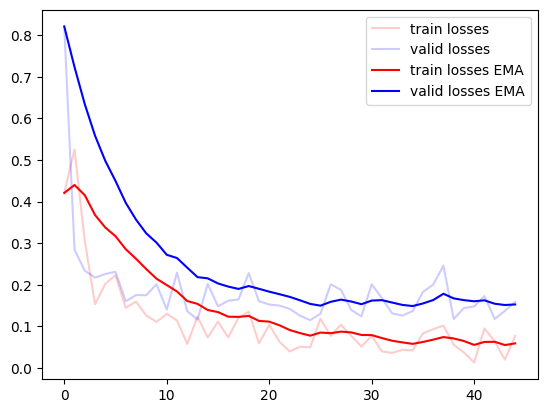

In [343]:
plt.plot(train_losses, label="train losses", color='r', alpha=0.2)
plt.plot(valid_losses, label="valid losses", color='b', alpha=0.2)
plt.plot(numpy_ewma_vectorized_v2(np.array(train_losses)), label="train losses EMA", color='r')
plt.plot(numpy_ewma_vectorized_v2(np.array(valid_losses)), label="valid losses EMA", color='b')
plt.legend()

# Test: feature matching

Let's compute the model test metrics

> First we need to load the best model weights





## Load checkpoint

In [344]:
if running_on_colab:
    path = os.path.join(drive_path, "MyDrive", "tinypointnetmodel.yml")
else:
    path = os.path.join("tinypointnetmodel.yml")
tinypointnet = TinyPointNet()
tinypointnet.load_state_dict(torch.load(path))
tinypointnet.to(device)

TinyPointNet(
  (input_transform): TNet(
    (mlp1): MLP(
      (conv): Conv1d(3, 64, kernel_size=(1,), stride=(1,))
      (bn): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (mlp2): MLP(
      (conv): Conv1d(64, 128, kernel_size=(1,), stride=(1,))
      (bn): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (mlp3): MLP(
      (conv): Conv1d(128, 1024, kernel_size=(1,), stride=(1,))
      (bn): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (fc_bn1): FC_BN(
      (lin): Linear(in_features=1024, out_features=512, bias=True)
      (bn): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (fc_bn2): FC_BN(
      (lin): Linear(in_features=512, out_features=256, bias=True)
      (bn): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (fc3): Linear(in_features=256, out_features=9, bias

## Prepare the test set

In [345]:
test_ds.generate_test_set(0, 2000)

## build the ground truth nearest neighbors
## in other words, find thepoints in the noisy test points
## that are the nearest neighbors to the original, sampled, test points
test_ds.generate_noisy_test_set(0)


100%|██████████| 36/36 [00:00<00:00, 29888.15it/s]


### Visualize the sampled test points
Little red spheres represent the test points sampled from the original test mesh

In [346]:
pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(test_ds.test_points_sampled_n)
pcd.paint_uniform_color([0.5, 0.5, 0.5])
geoms = [pcd]

# visualize the colored point cloud
if running_on_colab:
    draw_geometries(geoms)
else:
    o3d.visualization.draw_geometries(geoms)

In [347]:
pcd = test_ds.get_sampled_pointcloud(mesh_idx=0, N=5000)
pcd.paint_uniform_color([0.5, 0.5, 0.5])
geoms = [pcd]
for point in test_ds.test_points_sampled_n:
    sphere = o3d.geometry.TriangleMesh.create_sphere(radius=1e-3)
    sphere.translate(point)
    sphere.paint_uniform_color([1, 0, 0])
    geoms.append(sphere)

# visualize the colored point cloud
if running_on_colab:
    draw_geometries(geoms)
else:
    o3d.visualization.draw_geometries(geoms)


### Compute the descriptor of each point in each point set

In [348]:
descs   = test_ds.compute_descriptors(tinypointnet)
descs_n = test_ds.compute_descriptors(tinypointnet, noisy=True)

100%|██████████| 36/36 [00:01<00:00, 24.93it/s]


## matching time!
In other words, get the descriptor from the noisy point cloud which is closest to the query descriptor from the original point cloud

In [349]:
pcd = test_ds.get_sampled_pointcloud(mesh_idx=0, N=5000)
pcd.paint_uniform_color([0.5, 0.5, 0.5])
geoms = [pcd]
for row in tqdm(range(test_ds.test_points_sampled_n.shape[0])):
    anchor       = test_ds.test_points_sampled[row]
    sphere = o3d.geometry.TriangleMesh.create_sphere(radius=1e-3)
    sphere.translate(anchor)
    sphere.paint_uniform_color([1, 0, 0])
    geoms.append(sphere)

if running_on_colab:
    draw_geometries(geoms)
else:
    o3d.visualization.draw_geometries(geoms)

100%|██████████| 36/36 [00:00<00:00, 14005.65it/s]


In [350]:
print(descs_n.shape)

(36, 1024)


In [351]:
correct = tot = 0

for row in tqdm(range(test_ds.test_points_sampled.shape[0])):
    desc = descs[row, :]
    dists = []
    anchor       = test_ds.test_points_sampled[row]
    true_near_pt = test_ds.test_points_sampled_n[row]

    for row2 in range(test_ds.test_points_sampled_n.shape[0]):
        desc2 = descs_n[row2, :]
        dist = np.linalg.norm(desc - desc2)
        dists.append(dist)

    min_row = np.argmin(np.asarray(dists))
    pred_pt = test_ds.test_points_sampled_n[min_row].squeeze()
    dist = np.linalg.norm(true_near_pt - pred_pt)
    visualize(test_ds.test_points_sampled,
              anchor = anchor,
              positive = pred_pt,
              radius=test_ds.radius)
    if dist<test_ds.radius:
        correct += 1
    tot += 1

print()
print(f"accuracy: {correct*100/tot:6.3f}%")


  0%|          | 0/36 [00:00<?, ?it/s]

 14%|█▍        | 5/36 [00:00<00:00, 44.14it/s]

 28%|██▊       | 10/36 [00:00<00:00, 43.33it/s]

 44%|████▍     | 16/36 [00:00<00:00, 46.97it/s]

 58%|█████▊    | 21/36 [00:00<00:00, 44.37it/s]

 72%|███████▏  | 26/36 [00:00<00:00, 44.38it/s]

 86%|████████▌ | 31/36 [00:00<00:00, 43.40it/s]

100%|██████████| 36/36 [00:00<00:00, 43.12it/s]


accuracy: 86.111%
